# Bussiness Problem

The company Insurance all performed 127.000 with 380.000 customers about their interest in a new auto-insurance product. Their customer will demonstrate or not their interest in purchase the insurance.

    
As a result of our work we will produce a report with our analysis and the answers to the questions below:

   - Principal insights about more relevant attributes to custormers purchase an auto-insurance.
    
   - If the capacity of sales team increases to 40.000 calls, what would be the percetange of the customers interest in acquire an auto-insurance?
  
   - How many calls the sales team need to contact 80% of the customers interested in purchase an auto-insurance?


## Sprints - Schedule

**SPRINT 1 (05/01 - 12/01)**
 
   - Solution Planning (DONE);

   - Data Collection (DONE);

**SPRINT 2 (12/01 - 19/01)**

   - Descriptive Analysis(DONE);

   - Business Research (What is a cross-sell)(DONE);

**SPRINT 3 (19/01 - 26/01)**

   - Feature Engineering(DONE);

**SPRINT 4 (26/01 - 02/02)**

   - EDA(DONE);

   - Insight Report(DONE);


**SPRINT 5 (02/02 - 09/02)**

   - Implementation of Machine Learning Models(DONE);

**SPRINT 6 (09/02 - 16/02)**

   - Business Metrics (KPI);

   - Translate to business metrics;

**SPRINT 7 (16/02 - 23/02)**

Deploy of the Model in Production;

**SPRINT 8 (23/02 - 02/03)**

Access of the data in the Model in Production;

**SPRINT 9 (02/03 - 09/03)**

Presentation to Business Team;

**SPRINT 10 (09/03 - 16/03)**

Write an article;
What I Learned;

## Imports

In [1]:
# System
import os

# Collect and Manipulate data
import pickle
import requests
import psycopg2
import numpy as np
import pandas as pd
#import postgres_crud as pc
from healthinsurance import postgres_crud as pc
                                                                    
# Viz\EDA
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pointbiserialr
from scipy.stats import chi2_contingency
from scikitplot.metrics import plot_confusion_matrix, plot_roc, plot_precision_recall, plot_cumulative_gain, plot_lift_curve

# Hipo Test
from scipy import stats
from scipy.stats import f_oneway
from scipy.stats import ttest_ind

# Feature Selection
from BorutaShap import BorutaShap

# preprocessing
from imblearn.pipeline import Pipeline
from imblearn.combine import SMOTETomek, SMOTEENN
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OrdinalEncoder, StandardScaler, RobustScaler, PowerTransformer

# ML
import xgboost as xgb
import lightgbm as lgb
from skopt import forest_minimize
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import StratifiedShuffleSplit as sss
from imblearn.ensemble import BalancedRandomForestClassifier, RUSBoostClassifier
from sklearn.metrics import accuracy_score, cohen_kappa_score, precision_score, f1_score, recall_score
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from healthinsurance import HealthInsurance
from healthinsurance import utils

import warnings
warnings.filterwarnings("ignore")

## Helper Functions

In [54]:
# Function to select the top null variables
def top_nulls(df, rate):
    null_vars = df.isna().mean().sort_values(ascending=False)
    return null_vars.loc[null_vars>rate].index.to_list()

# Function to convert rs to brl
def convert_rs_to_brl(x, rate):
    return x*rate

# Function to categorize the variable age
def cat_age(x):
    
    if x > 20 and x <= 25 :
        return 'Faixa_20_25'
    elif x > 25 and x <= 30:
        return 'Faixa_25_30'
    else:
        return 'Faixa_maior_30'
    
def Myheat_map(dataset, variaveis):

    df_corr = dataset[variaveis].corr()

    fig, ax = plt.subplots(figsize=(16, 10))
    # mask
    mask = np.triu(np.ones_like(df_corr, dtype=np.bool))
    # adjust mask and df
    mask = mask[1:, :-1]
    corr = df_corr.iloc[1:,:-1].copy()
    # color map
    cmap = sns.diverging_palette(0, 230, 90, 60, as_cmap=True)

    # plot heatmap
    sns.heatmap(corr, mask=mask, annot=True, fmt=".2f",
                   linewidths=5, cmap=cmap, vmin=-1, vmax=1, 
                   cbar_kws={"shrink": .8}, square=True)
    yticks = [i.upper() for i in corr.index]
    xticks = [i.upper() for i in corr.columns]
    plt.yticks(plt.yticks()[0], labels=yticks, rotation=0)
    plt.xticks(plt.xticks()[0], labels=xticks, rotation=20)

    # title
    title = 'CORRELATION MATRIX\n'
    plt.title(title, loc='left', fontsize=18)
    plt.show()
    
def cramer_v(var_x, var_y):

    # builds contigency matrix (or confusion matrix)
    confusion_matrix_v = pd.crosstab(var_x, var_y).values

    # gets the sum of all values in the matrix
    n = confusion_matrix_v.sum()

    # gets the rows, cols
    r, k = confusion_matrix_v.shape

    # gets the chi-squared
    chi2 = chi2_contingency(confusion_matrix_v)[0]

    # makes the bias correction
    chi2corr = max(0, chi2 - (k-1) * (r-1) / (n-1))
    kcorr = k - (k-1) ** 2 / (n-1)
    rcorr = r - (r-1) ** 2 / (n-1)

    # returns cramér V
    return np.sqrt((chi2corr/n) / min(kcorr-1, rcorr-1))

def hipo_test(*samples):

    samples = samples

    try:
        if len(samples) == 2:
            stat, p = ttest_ind(*samples)
        elif len(samples) > 2:
            stat, p = f_oneway(*samples)
    except:
        raise Exception("Deve ser fornecido pelo menos duas samples!!!")

    if p < 0.05:
        print(f'O valor de p é: {p}')
        print('Provável haver diferença')
    else:
        print(f'O valor de p é: {p}')
        print('Provável que não haja diferença')

    return stat, p

# Evaluate model by precision_at_k metric
def precision_at_k(data, k= 20000):
    
    # Reseting index
    data = data.reset_index(drop=True)
    
    # Creating ranking order
    data['ranking'] = data.index + 1
    data['response'] = data['response'].astype('int64') 
    data['precision_at_k'] = data['response'].cumsum()/data['ranking']
    
    return data.loc[k, 'precision_at_k']

# Evaluate model by recall_at_k metric
def recall_at_k(data, k=20000):
    
    # Reseting index
    data = data.reset_index(drop=True)
    data['response'] = data['response'].astype('int64') 
    data['recall_at_k'] = data['response'].cumsum() / data['response'].sum()
    
    return data.loc[k, 'recall_at_k']


# Function to tune the parameters
def tunnig_gridsearch(Xtrain, model, param_grid, cv, scoring, refit):

    """
    Função para tunnig de parâmetros utilizando o RandomizedSearchCV"""
    
    X_= Xtrain.drop('target', axis=1)
    y_= Xtrain['target']
    

    search = RandomizedSearchCV(estimator=model,
                            param_distributions=param_grid,
                            scoring=scoring,
                            refit=refit,
                                
                            cv=cv,
                            verbose=1,
                            n_jobs=-1,
                            return_train_score=True)
    search.fit(X_, y_)

    return search.best_params_, search.cv_results_


# Function to Model Selection
def model_selection(data_train, data_test, model, model_name, k=20000):
    
    # Split Data
    Xtrain = data_train.drop(['response'], axis=1)
    ytrain = data_train.response
    
    Xtest = data_test.drop(['response'], axis=1)
    ytest = data_test.response
    
    # fit and predict_proba
    model.fit(Xtrain, ytrain)
    pred = model.predict(Xtest)
    proba = model.predict_proba(Xtest)
    
    # 1d array
    proba_1d = proba[:,1].tolist()
    
    # Include in dataframe
    test_data = data_test.copy()
    test_data['score'] = proba_1d
    
    # Sort
    test_data = test_data.sort_values('score', ascending=False)

    # dados_test
    precision = precision_at_k(test_data, k)
    recall    = recall_at_k(test_data, k)
    
    return precision, recall


# Training the model with the tunned parameters
def train_evaluate_model(data_train, data_test, model, model_name, k=20000):
    
    # Split Data
    Xtrain = data_train.drop(['response'], axis=1)
    ytrain = data_train.response
    
    Xtest = data_test.drop(['response'], axis=1)
    ytest = data_test.response
    
    # fit and predict_proba
    model.fit(Xtrain, ytrain)
    pred = model.predict(Xtest)
    proba = model.predict_proba(Xtest)
    
    # 1d array
    proba_1d = proba[:,1].tolist()
    
    # Include in dataframe
    test_data = data_test.copy()
    test_data['score'] = proba_1d
    
    # Sort
    test_data = test_data.sort_values('score', ascending=False)


    # Salvando o modelo em pickle
    with open(f'../models/{model_name}', 'wb') as f:
        pickle.dump(model, f)

    # Painel
    painel_df = pd.DataFrame({'Model name': model_name,
                              'precision_at_k': precision_at_k(test_data, k),
                              'recall_at_k': recall_at_k(test_data, k)}, index=[0])
    
    
    _, (ax1, ax2) = plt.subplots(1,2, figsize=(14,6))
    plot_cumulative_gain(ytest, proba, ax=ax1)
    plot_lift_curve(ytest, proba, ax=ax2)
    plt.savefig(f'../report/{model_name}'+"_pic.png")

    return painel_df, model

# CrossValidation
def cross_validation(model, model_name, training_Data, k_top, kfolds, verbose=False):
    
    xtrain = training_data.drop(['target'], axis=1)
    ytrain = training_data.target
    
    # cross-validation
    cv = sss(n_splits=kfolds)
    prec_k_list = []
    rec_k_list = []
    for train_index, val_index in cv,split(xtrain, ytrain):
        X_train, Xval = xtrain.iloc[train_index], xtrain.iloc[val_index]
        y_train, yval = ytrain.iloc[train_index], ytrain.iloc[val_index]
        
        # fit and predict_proba
        model.fit(X_train, y_train)
        yhat_proba = model.predict_proba(Xval)
        
        #transform yhat_proba to 1D-array
        yhat_proba_1d = yhat_proba[:, 1].tolist()
        
        #reconstruct dataframe
        full_val = pd.concat([Xval, yval], axis=1)
        full_val['score'] = yhat_proba_1d
        full_val = full_val.sort_values('score', ascending=False)
        
        #evaluate metrics and store in list
        prec_k_list.append(precision_at_k(full_val, k_top))
        rec_k_list.append(recall_at_k(full_val, k_top))
        
    # evaluate mean an std
    prec_k_pred = np.round(np.mean(prec_klist), 4).astype(str) + '+/-' + np.round(np.std(prec_k_list), 4).astype(str) 
    rec_k_pred =  np.round(np.mean(rec_k_list), 4).astype(str) + '+/-' + np.round(np.std(prec_k_list), 4).astype(str)
    
    return pd.DataFrame({'Model name': model_name,
                         'precision_at_k': prec_k_pred,
                         'recall_at_k': rec_k_pred}, index=[0])

# Coletando os Dados

## Conhecendo as tabelas do BD.

In [5]:
# Parametros
HOST =     ##### 
PORT =     ##### 
DATABASE = ##### 
USERNAME = ##### 
PASSWORD = ##### 

# Query SQL to find the tables names
query =   """
          SELECT table_name 
          FROM information_schema.tables
          WHERE table_schema='pa004'
          AND table_type='BASE TABLE';
          
          """

data = pc.Postgresql.retrieve_data(query=query,
                                   user=USERNAME,
                                   password=PASSWORD,
                                   host=HOST,
                                   port=PORT,
                                   database=DATABASE,
                                   connect=True,
                                   objeto = 'pd')

data

Buscando os dados!!!
Conexão com Postgresql fechada


,table_name
0,users
1,vehicle
2,insurance


Cool we have three tables to work with 'users', 'vehicle', 'insurance'. Let's get them individually.

In [6]:
# querys
query_insurance = """SELECT * FROM pa004.insurance; """
query_users = """SELECT * FROM pa004.users; """
query_vehicle = """SELECT * FROM pa004.vehicle; """

QUERY_LIST = [query_insurance,query_users, query_vehicle]

# Generating a list of dataframes
dataframes = []
for query in QUERY_LIST:
    
    data = pc.Postgresql.retrieve_data(query=query,
                                   user=USERNAME,
                                   password=PASSWORD,
                                   host=HOST,
                                   port=PORT,
                                   database=DATABASE,
                                   connect=True,
                                   objeto = 'pd')
    dataframes.append(data)
    

# Checking duplicated ids
print("\nThere is duplicated ids ?")
for i in range(0,3):
    df = dataframes[i]
    dp = df[['id']].duplicated()
    result = dp.unique()
    print(f'\nDuplicated ids in df {i} - {result}')

Buscando os dados!!!
Conexão com Postgresql fechada
Buscando os dados!!!
Conexão com Postgresql fechada
Buscando os dados!!!
Conexão com Postgresql fechada

There is duplicated ids ?

Duplicated ids in df 0 - [False]

Duplicated ids in df 1 - [False]

Duplicated ids in df 2 - [False]


In [7]:
# Splitting the dataframes in differents DFs.

# Insurance df
insurance_df = dataframes[0]
# Users df
users_df = dataframes[1]
# Vehicle df
vehicles_df = dataframes[2]

# Logical Test - we want a empty set
diff = set(insurance_df['id']).difference(set(users_df['id']), set(vehicles_df['id']))
print(diff)

set()


In [8]:
dataframes[2].head()

,id,driving_license,vehicle_age,vehicle_damage
0,1,1,> 2 Years,Yes
1,2,1,1-2 Year,No
2,3,1,> 2 Years,Yes
3,4,1,< 1 Year,No
4,5,1,< 1 Year,No


## Retriving all data with one Query

In [9]:
# Query SQL to find the tables names
query =   """
            SELECT * 
            FROM pa004.insurance i
            INNER JOIN pa004.users u
                 on i.id = u.id 
            INNER JOIN pa004.vehicle v
                 on u.id = v.id
          """

data = pc.Postgresql.retrieve_data(query=query,
                                   user=USERNAME,
                                   password=PASSWORD,
                                   host=HOST,
                                   port=PORT,
                                   database=DATABASE,
                                   connect=True,
                                   objeto = 'pd')

data.head()

Buscando os dados!!!
Conexão com Postgresql fechada


,id,previously_insured,annual_premium,vintage,response,id,gender,age,region_code,policy_sales_channel,id,driving_license,vehicle_age,vehicle_damage
0,7,0,23367.0,249,0,7,Male,23,11.0,152.0,7,1,< 1 Year,Yes
1,13,1,31409.0,221,0,13,Female,41,15.0,14.0,13,1,1-2 Year,No
2,18,1,46622.0,299,0,18,Female,25,35.0,152.0,18,1,< 1 Year,No
3,31,0,2630.0,136,0,31,Female,26,8.0,160.0,31,1,< 1 Year,No
4,39,0,42297.0,264,0,39,Male,45,8.0,124.0,39,1,1-2 Year,Yes


In [10]:
# Saving the data in disk, this way we dont need to send unnecessary requests to our database.
data.to_csv('data/full_database.csv')

# Data Description

## Variable Index

**id:**                      Unique ID for the customer

**Gender:** 	             Gender of the customer

**Age:** 	                 Age of the customer

**Driving_License:** 	     0 : Customer does not have DL, 1 : Customer already has DL

**Region_Code:** 	         Unique code for the region of the customer

**Previously_Insured:** 	 1 : Customer already has Vehicle Insurance, 0 : Customer doesn't have Vehicle Insurance

**Vehicle_Age:** 	         Age of the Vehicle

**Vehicle_Damage:** 	     1 : Customer got his/her vehicle damaged in the past. 0 : Customer didn't get his/her vehicle damaged in the past.

**Annual_Premium:** 	     The amount customer needs to pay as premium in the year   **- Values in Rs(Indian Rupee)**

**PolicySalesChannel:** 	 Anonymized Code for the channel of outreaching to the customer ie. Different Agents, Over Mail, Over Phone, In Person, etc.

**Vintage:**	             Number of Days, Customer has been associated with the company

**Response:**                1 : Customer is interested, 0 : Customer is not interested

## Collecting data from Disk

In [3]:
# Collecting the data from disk.
data = pd.read_csv('../data/full_database.csv')

# Dropping redudant columns.
data.drop(['Unnamed: 0','id.1','id.2'], inplace=True, axis=1)

In [4]:
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,< 1 Year,Yes
1,13,1,31409.0,221,0,Female,41,15.0,14.0,1,1-2 Year,No
2,18,1,46622.0,299,0,Female,25,35.0,152.0,1,< 1 Year,No
3,31,0,2630.0,136,0,Female,26,8.0,160.0,1,< 1 Year,No
4,39,0,42297.0,264,0,Male,45,8.0,124.0,1,1-2 Year,Yes


## General Describe of Data. 

In [5]:
# Describe
pd.DataFrame({'missing' :data.isna().mean(),
              'uniques' :data.nunique(),
              'dtypes'  :data.dtypes,
              'min'     :data.min(),
              'mean'    :data.mean(),
              'median'  :data.median(),
              'max'     :data.max(),
              'skew'    :data.skew(),
              'kurtosis':data.kurtosis()})

,missing,uniques,dtypes,min,mean,median,max,skew,kurtosis
age,0.0,66,int64,20,38.822584,36.0,85,6.725390e-01,-0.565655
annual_premium,0.0,48838,float64,2630.0,30564.389581,31669.0,540165.0,1.766087e+00,34.004569
driving_license,0.0,2,int64,0,0.997869,1.0,1,-2.159518e+01,464.354302
gender,0.0,2,object,Female,NaN,NaN,Male,NaN,NaN
id,0.0,381109,int64,1,190555.000000,190555.0,381109,-8.071174e-18,-1.200000
policy_sales_channel,0.0,155,float64,1.0,112.034295,133.0,163.0,-9.000081e-01,-0.970810
previously_insured,0.0,2,int64,0,0.458210,0.0,1,1.677471e-01,-1.971871
region_code,0.0,53,float64,0.0,26.388807,28.0,52.0,-1.152664e-01,-0.867857
response,0.0,2,int64,0,0.122563,0.0,1,2.301906e+00,3.298788
vehicle_age,0.0,3,object,1-2 Year,NaN,NaN,> 2 Years,NaN,NaN


 - We have no missing value.
 - annual_premium, policy_sales_channel, region_code, vintage has diferent scales min: 2630.0  max: 540165.0.
 - driving_license, previously_insured, vehicle_age, vehicle_damage, previously_insured is categorical feature and not int64.
 - the annual_premium has large values for brazillian standarts we will convert it from Rs (Indian Rupee) to BRL (Brazilliam Real)
 - response is our Target variable.
 - id is our unique feature.

## Changing dtypes of our dataset

In [6]:
# Category variabels
variables = ['driving_license',
             'region_code',
             'policy_sales_channel',
             'previously_insured', 
             'vehicle_age', 
             'vehicle_damage', 
             'previously_insured', 
             'gender',
             'response']

for var in variables:
    data[var] = data[var].astype('category')

## Target - response

response
0    87.743664
1    12.256336
Name: id, dtype: float64

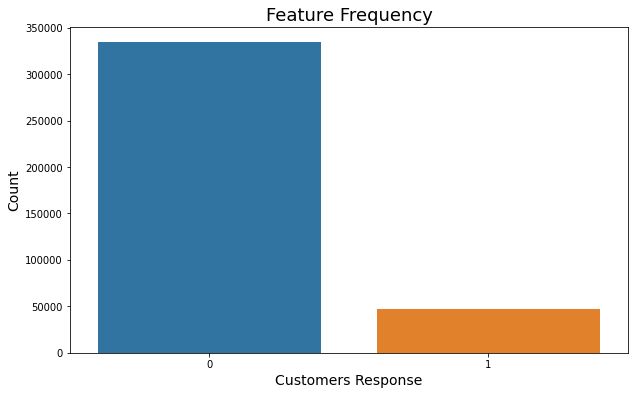

In [7]:
# Checkando o balanciamento da variável Target
ax = sns.countplot(x='response', hue=None, data=data)
ax.figure.set_size_inches(10, 6)
ax.set_title('Feature Frequency', fontsize=18, loc='center')
ax.set_xlabel('Customers Response', fontsize=14)
ax.set_ylabel('Count', fontsize=14)
ax=ax

# Percentual de observações por valores Geography
data.groupby('response').count()['id'].apply(lambda x: (x/data.shape[0])*100)

- We have an unbalanced target with 87.74% to not interested and 12.25% to interest in purchase the insurance.

## Gender vs Response

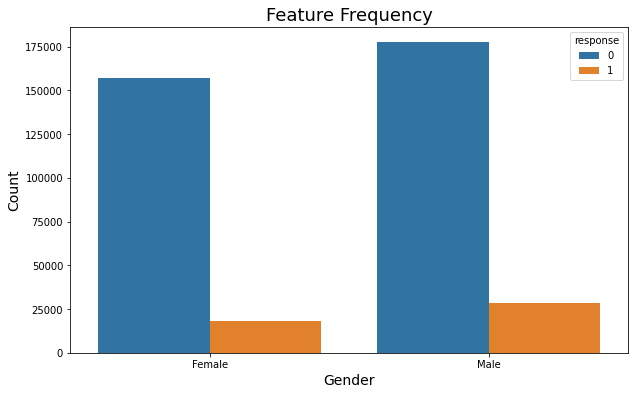

In [8]:
ax = sns.countplot(x='gender', hue='response', data=data)
ax.figure.set_size_inches(10, 6)
ax.set_title('Feature Frequency', fontsize=18, loc='center')
ax.set_xlabel('Gender', fontsize=14)
ax.set_ylabel('Count', fontsize=14)
ax=ax

In [9]:
# Porcentage of observations by Gender
data.groupby('gender').count()['id'].apply(lambda x: (x/data.shape[0])*100)

gender
Female    45.92387
Male      54.07613
Name: id, dtype: float64

- We cant find a concentration of the positive event by gender. With the majority of males

## driving_license vs response

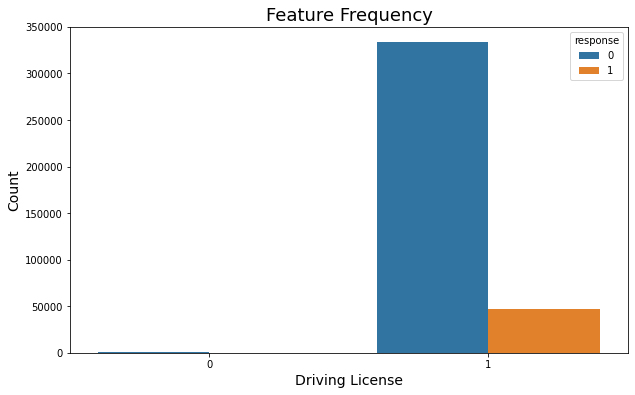

In [10]:
ax = sns.countplot(x='driving_license', hue='response', data=data)
ax.figure.set_size_inches(10, 6)
ax.set_title('Feature Frequency', fontsize=18, loc='center')
ax.set_xlabel('Driving License', fontsize=14)
ax.set_ylabel('Count', fontsize=14)
ax=ax

In [11]:
# Porcentage of observations by driving_license
data.groupby('driving_license').count()['id'].apply(lambda x: (x/data.shape[0])*100)

driving_license
0     0.213062
1    99.786938
Name: id, dtype: float64

- We can see that the majority of our customers has driving license.

## previously_insured vs response

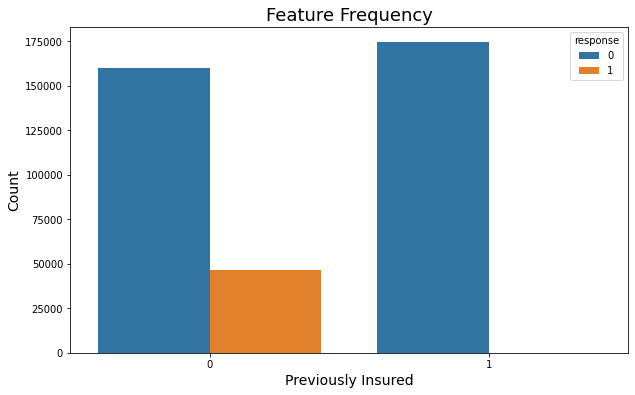

In [12]:
ax = sns.countplot(x='previously_insured', hue='response', data=data)
ax.figure.set_size_inches(10, 6)
ax.set_title('Feature Frequency', fontsize=18, loc='center')
ax.set_xlabel('Previously Insured', fontsize=14)
ax.set_ylabel('Count', fontsize=14)
ax=ax

In [13]:
# Porcentage of observations by previously_insured
data.groupby('previously_insured').count()['id'].apply(lambda x: (x/data.shape[0])*100)

previously_insured
0    54.178988
1    45.821012
Name: id, dtype: float64

- We can see that the interest in purchase a insurance is higher when you dont have a previously insured.

## vehicle_age vs response

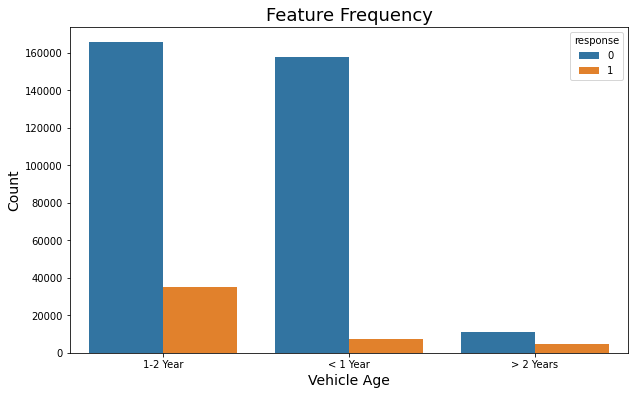

In [14]:
ax = sns.countplot(x='vehicle_age', hue='response', data=data)
ax.figure.set_size_inches(10, 6)
ax.set_title('Feature Frequency', fontsize=18, loc='center')
ax.set_xlabel('Vehicle Age', fontsize=14)
ax.set_ylabel('Count', fontsize=14)
ax=ax

- Strong concentration of interest with owner between 1 and 2 years also its the majority in the 1-2 Year category.

In [15]:
# Porcentage of observations by previously_insured
data.groupby('vehicle_age').count()['id'].apply(lambda x: (x/data.shape[0])*100)

vehicle_age
1-2 Year     52.561341
< 1 Year     43.238549
> 2 Years     4.200111
Name: id, dtype: float64

## vehicle_damage vs response

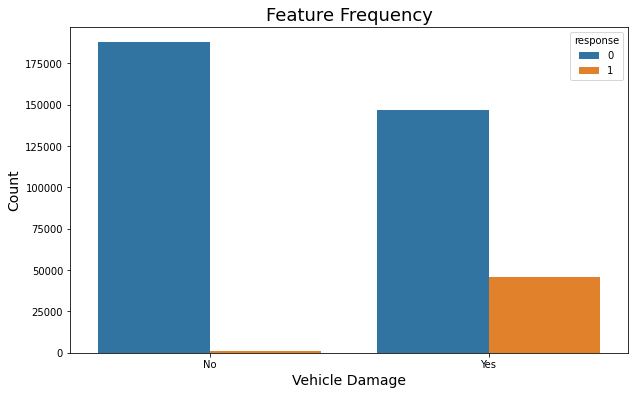

In [16]:
ax = sns.countplot(x='vehicle_damage', hue='response', data=data)
ax.figure.set_size_inches(10, 6)
ax.set_title('Feature Frequency', fontsize=18, loc='center')
ax.set_xlabel('Vehicle Damage', fontsize=14)
ax.set_ylabel('Count', fontsize=14)
ax=ax

- Strong concentration of interest with owners of damaged vehicle.

In [17]:
# Porcentage of observations by previously_insured
data.groupby('vehicle_damage').count()['id'].apply(lambda x: (x/data.shape[0])*100)

vehicle_damage
No     49.512344
Yes    50.487656
Name: id, dtype: float64

## Cheking the presense of outliers

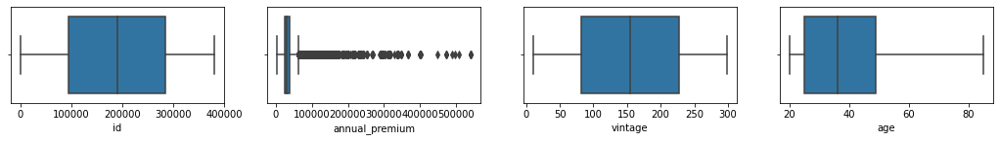

In [18]:
# Variáveis
variables = data.select_dtypes(['int64', 'float64']).columns.to_list()

# Setando a posicão inicial
n = 1

plt.figure(figsize=(18, 10))
for column in data[variables].columns:
    plt.subplot(4, 4, n)
    _ = sns.boxplot(x=column, data=data)
    n += 1

plt.subplots_adjust(hspace=0.5)
plt.show()

- We can observe outliers at annual_premimum.

### annual_premium

In [19]:
# Calculando o Q1 e Q3 e IQR
Q1 = np.quantile(data['annual_premium'], .25)
Q3 = np.quantile(data['annual_premium'], .75)
IQR = Q3 - Q1

# Calculando os limites low and high
low = Q1 - 1.5 * IQR
high = Q3 + 1.5 * IQR

# priting the limits
print(f'Low Limit is {low}')
print(f'High Limit is {high}')

Low Limit is 1912.5
High Limit is 61892.5


# Feature Engineering

## Creating the previously_insured by gender variable

In [5]:
# soma de previously_insured by gender
data['previously_insured'] = data['previously_insured'].astype('int64')
pi_by_gender = pd.DataFrame(data.groupby(by='gender').sum()['previously_insured'])
pi_by_gender.reset_index(inplace=True)

data = data.merge(pi_by_gender, left_on='gender', right_on='gender', how='left')
data.rename(columns={'previously_insured_y':'previously_insured_bygender','previously_insured_x':'previously_insured'}, inplace=True)

In [6]:
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,< 1 Year,Yes,86679
1,13,1,31409.0,221,0,Female,41,15.0,14.0,1,1-2 Year,No,87949
2,18,1,46622.0,299,0,Female,25,35.0,152.0,1,< 1 Year,No,87949
3,31,0,2630.0,136,0,Female,26,8.0,160.0,1,< 1 Year,No,87949
4,39,0,42297.0,264,0,Male,45,8.0,124.0,1,1-2 Year,Yes,86679


## Converting the annual premium

In [7]:
# Exchabge Rate - BRL X Rs = 0.07490
data['annual_premium_brl'] = data['annual_premium'].apply(lambda x: x*0.07490)

In [8]:
# Annual_premium_brl created - We will use annual_premium_brl
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,< 1 Year,Yes,86679,1750.1883
1,13,1,31409.0,221,0,Female,41,15.0,14.0,1,1-2 Year,No,87949,2352.5341
2,18,1,46622.0,299,0,Female,25,35.0,152.0,1,< 1 Year,No,87949,3491.9878
3,31,0,2630.0,136,0,Female,26,8.0,160.0,1,< 1 Year,No,87949,196.9870
4,39,0,42297.0,264,0,Male,45,8.0,124.0,1,1-2 Year,Yes,86679,3168.0453


## annual_premium_brl squared

In [9]:
data['annual_premium_brl_squared'] = data['annual_premium_brl'].apply(lambda x: x**2)
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,< 1 Year,Yes,86679,1750.1883,3.063159e+06
1,13,1,31409.0,221,0,Female,41,15.0,14.0,1,1-2 Year,No,87949,2352.5341,5.534417e+06
2,18,1,46622.0,299,0,Female,25,35.0,152.0,1,< 1 Year,No,87949,3491.9878,1.219398e+07
3,31,0,2630.0,136,0,Female,26,8.0,160.0,1,< 1 Year,No,87949,196.9870,3.880388e+04
4,39,0,42297.0,264,0,Male,45,8.0,124.0,1,1-2 Year,Yes,86679,3168.0453,1.003651e+07


## annual_premium_brl by region_code

In [10]:
# soma de annual_premium by region_code
annual_premium_byregioncode = pd.DataFrame(data.groupby(by='region_code').sum()['annual_premium_brl'])
annual_premium_byregioncode.reset_index(inplace=True)

In [11]:
data = data.merge(annual_premium_byregioncode, left_on='region_code', right_on='region_code', how='left')
data.rename(columns={'annual_premium_brl_y':'annual_premium_brl_byregionCode','annual_premium_brl_x':'annual_premium_brl'}, inplace=True)
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,< 1 Year,Yes,86679,1750.1883,3.063159e+06,1.908980e+07
1,13,1,31409.0,221,0,Female,41,15.0,14.0,1,1-2 Year,No,87949,2352.5341,5.534417e+06,2.952881e+07
2,18,1,46622.0,299,0,Female,25,35.0,152.0,1,< 1 Year,No,87949,3491.9878,1.219398e+07,1.395194e+07
3,31,0,2630.0,136,0,Female,26,8.0,160.0,1,< 1 Year,No,87949,196.9870,3.880388e+04,9.253340e+07
4,39,0,42297.0,264,0,Male,45,8.0,124.0,1,1-2 Year,Yes,86679,3168.0453,1.003651e+07,9.253340e+07


## annual_premium_brl by policy_sales_channel

In [12]:
# soma de annual_premium by policy_sales_channel
annual_premium_bypolicySalesChannel = pd.DataFrame(data.groupby(by='policy_sales_channel').sum()['annual_premium_brl'])
annual_premium_bypolicySalesChannel.reset_index(inplace=True)

In [13]:
data = data.merge(annual_premium_bypolicySalesChannel, left_on='policy_sales_channel', right_on='policy_sales_channel', how='left')
data.rename(columns={'annual_premium_brl_y':'annual_premium_bypolicySalesChannel','annual_premium_brl_x':'annual_premium_brl'}, inplace=True)
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode,annual_premium_bypolicySalesChannel
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,< 1 Year,Yes,86679,1750.1883,3.063159e+06,1.908980e+07,3.118363e+08
1,13,1,31409.0,221,0,Female,41,15.0,14.0,1,1-2 Year,No,87949,2352.5341,5.534417e+06,2.952881e+07,1.578267e+06
2,18,1,46622.0,299,0,Female,25,35.0,152.0,1,< 1 Year,No,87949,3491.9878,1.219398e+07,1.395194e+07,3.118363e+08
3,31,0,2630.0,136,0,Female,26,8.0,160.0,1,< 1 Year,No,87949,196.9870,3.880388e+04,9.253340e+07,4.172036e+07
4,39,0,42297.0,264,0,Male,45,8.0,124.0,1,1-2 Year,Yes,86679,3168.0453,1.003651e+07,9.253340e+07,1.757450e+08


## annual_premium_brl divided by vintage

In [14]:
data['annual_premium/vintage'] = data['annual_premium_brl']/data['vintage']
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode,annual_premium_bypolicySalesChannel,annual_premium/vintage
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,< 1 Year,Yes,86679,1750.1883,3.063159e+06,1.908980e+07,3.118363e+08,7.028869
1,13,1,31409.0,221,0,Female,41,15.0,14.0,1,1-2 Year,No,87949,2352.5341,5.534417e+06,2.952881e+07,1.578267e+06,10.644951
2,18,1,46622.0,299,0,Female,25,35.0,152.0,1,< 1 Year,No,87949,3491.9878,1.219398e+07,1.395194e+07,3.118363e+08,11.678889
3,31,0,2630.0,136,0,Female,26,8.0,160.0,1,< 1 Year,No,87949,196.9870,3.880388e+04,9.253340e+07,4.172036e+07,1.448434
4,39,0,42297.0,264,0,Male,45,8.0,124.0,1,1-2 Year,Yes,86679,3168.0453,1.003651e+07,9.253340e+07,1.757450e+08,12.000172


## Age Categorical

In [15]:
data['cat_age'] = data['age'].apply(lambda x: 'Faixa_20_25' if x > 20 and x <= 25 else 'Faixa_25_30' if  x > 25 and x <= 30 else 'Faixa_maior_30')
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode,annual_premium_bypolicySalesChannel,annual_premium/vintage,cat_age
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,< 1 Year,Yes,86679,1750.1883,3.063159e+06,1.908980e+07,3.118363e+08,7.028869,Faixa_20_25
1,13,1,31409.0,221,0,Female,41,15.0,14.0,1,1-2 Year,No,87949,2352.5341,5.534417e+06,2.952881e+07,1.578267e+06,10.644951,Faixa_maior_30
2,18,1,46622.0,299,0,Female,25,35.0,152.0,1,< 1 Year,No,87949,3491.9878,1.219398e+07,1.395194e+07,3.118363e+08,11.678889,Faixa_20_25
3,31,0,2630.0,136,0,Female,26,8.0,160.0,1,< 1 Year,No,87949,196.9870,3.880388e+04,9.253340e+07,4.172036e+07,1.448434,Faixa_25_30
4,39,0,42297.0,264,0,Male,45,8.0,124.0,1,1-2 Year,Yes,86679,3168.0453,1.003651e+07,9.253340e+07,1.757450e+08,12.000172,Faixa_maior_30


## Median by policy_sales_channel

In [16]:
dados_temp = data.groupby('policy_sales_channel')['annual_premium_brl'].median()
dados_temp = pd.DataFrame(dados_temp)

In [17]:
data = data.merge(dados_temp, on='policy_sales_channel')
data.rename(columns={'annual_premium_brl_y': 'median_by_policy',
                     'annual_premium_brl_x':'annual_premium_brl'}, inplace=True)

In [18]:
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode,annual_premium_bypolicySalesChannel,annual_premium/vintage,cat_age,median_by_policy
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,< 1 Year,Yes,86679,1750.1883,3.063159e+06,1.908980e+07,3.118363e+08,7.028869,Faixa_20_25,2303.6244
1,18,1,46622.0,299,0,Female,25,35.0,152.0,1,< 1 Year,No,87949,3491.9878,1.219398e+07,1.395194e+07,3.118363e+08,11.678889,Faixa_20_25,2303.6244
2,73,1,40372.0,242,0,Female,23,39.0,152.0,1,< 1 Year,No,87949,3023.8628,9.143746e+06,9.350760e+06,3.118363e+08,12.495301,Faixa_20_25,2303.6244
3,95,0,41641.0,209,0,Female,23,15.0,152.0,1,< 1 Year,Yes,87949,3118.9109,9.727605e+06,2.952881e+07,3.118363e+08,14.923019,Faixa_20_25,2303.6244
4,120,0,2630.0,149,0,Female,23,25.0,152.0,1,< 1 Year,No,87949,196.9870,3.880388e+04,4.816112e+06,3.118363e+08,1.322060,Faixa_20_25,2303.6244


## Frequency Encoding region_cod

In [19]:
df_temp = pd.DataFrame(data.groupby('region_code')['id'].count())
df_temp.reset_index(inplace=True)

In [20]:
data = data.merge(df_temp, on='region_code')
data.rename(columns={'id_y': 'Freq_region_code',
                     'id_x':'id'}, inplace=True)

## Frequency Encoding policy_sales_channel

In [21]:
df_temp = pd.DataFrame(data.groupby('policy_sales_channel')['id'].count())
df_temp.reset_index(inplace=True)

In [22]:
data = data.merge(df_temp, on='policy_sales_channel')
data.rename(columns={'id_y': 'Freq_policy_sales_channel',
                     'id_x':'id'}, inplace=True)

In [23]:
data.head()

,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,...,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode,annual_premium_bypolicySalesChannel,annual_premium/vintage,cat_age,median_by_policy,Freq_region_code,Freq_policy_sales_channel
0,7,0,23367.0,249,0,Male,23,11.0,152.0,1,...,86679,1750.1883,3.063159e+06,1.908980e+07,3.118363e+08,7.028869,Faixa_20_25,2303.6244,9232,134784
1,1449,1,23950.0,227,0,Female,25,11.0,152.0,1,...,87949,1793.8550,3.217916e+06,1.908980e+07,3.118363e+08,7.902445,Faixa_20_25,2303.6244,9232,134784
2,1704,1,24420.0,268,0,Male,24,11.0,152.0,1,...,86679,1829.0580,3.345453e+06,1.908980e+07,3.118363e+08,6.824843,Faixa_20_25,2303.6244,9232,134784
3,3112,0,34696.0,32,0,Female,23,11.0,152.0,1,...,87949,2598.7304,6.753400e+06,1.908980e+07,3.118363e+08,81.210325,Faixa_20_25,2303.6244,9232,134784
4,5032,1,29861.0,191,0,Female,23,11.0,152.0,1,...,87949,2236.5889,5.002330e+06,1.908980e+07,3.118363e+08,11.709890,Faixa_20_25,2303.6244,9232,134784


# EDA

## Univariate Analysis

### Variáveis Categoricas

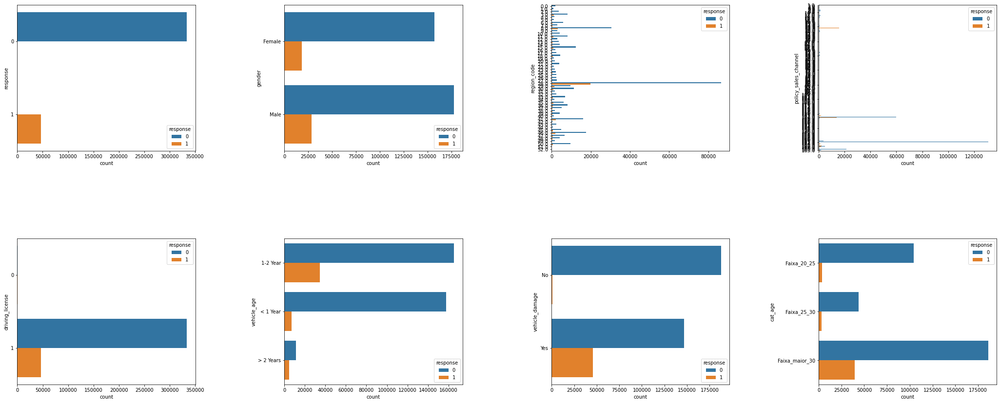

In [39]:
# checking the outliers again.
# Variáveis
variables = data.select_dtypes(['category', 'object']).columns.to_list()

# Setando a posicão inicial
n = 1

plt.figure(figsize=(36, 32))
for column in data[variables].columns:
    plt.subplot(4, 4, n)
    _ = sns.countplot(y=column,hue='response', data=data)
    n += 1

plt.subplots_adjust(hspace=0.6,wspace=0.5)
plt.show()

- We can basically see the same points highlighted in descriptive analysis section
- We also can see that policy_sales_channel and region_code have a lot categorys but with some of them getting a high frequency.

Bellow the Top 5 categorys of region_code and policy_sales_channel we can see the main regions and channels of our customers.

In [40]:
# Top region_code
region_code = data.groupby('region_code').count()['id']
region_code.sort_values(ascending=False).head()

region_code
28.0    106415
8.0      33877
46.0     19749
41.0     18263
15.0     13308
Name: id, dtype: int64

In [41]:
# Top policy_sales_channel
policy_sales = data.groupby('policy_sales_channel').count()['id']
policy_sales.sort_values(ascending=False).head()

policy_sales_channel
152.0    134784
26.0      79700
124.0     73995
160.0     21779
156.0     10661
Name: id, dtype: int64

### Variáveis Númericas

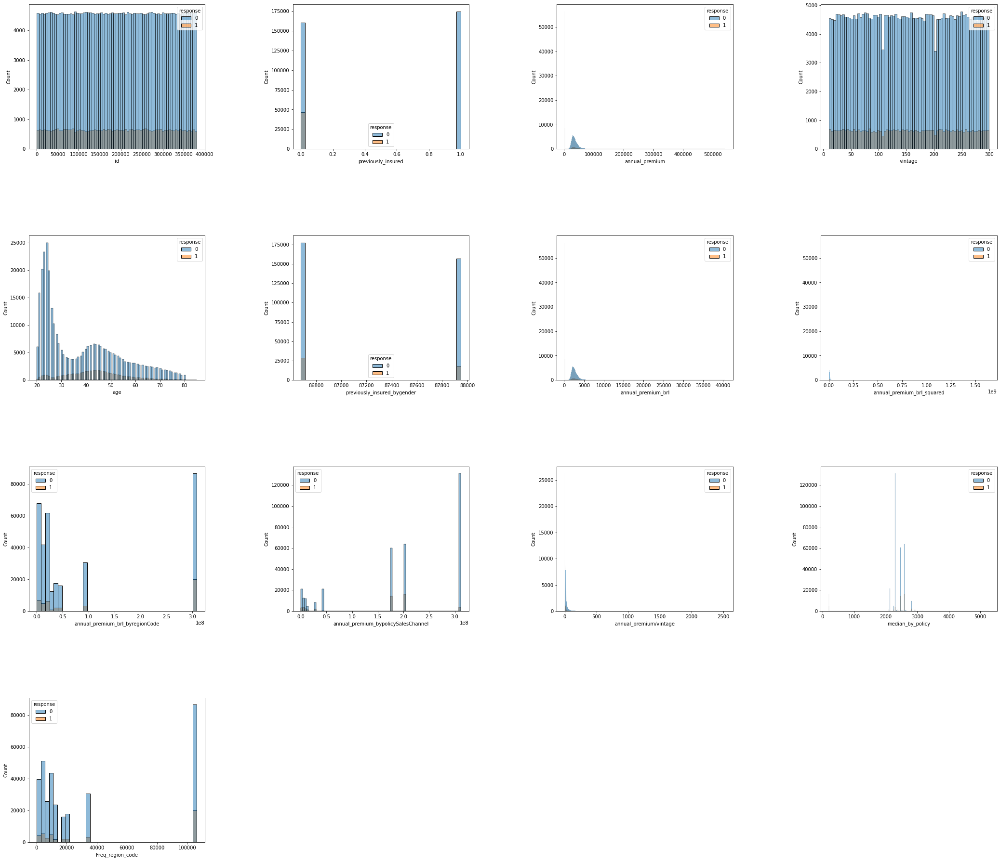

In [42]:
# Antes do feature eng
variables = data.select_dtypes(['int64','float64']).columns.to_list()
#variables.remove('RowNumber'), variables.remove('CustomerId')

# Setando a posicão inicial
n = 1

plt.figure(figsize=(36, 32))
for column in data[variables].columns[:len(variables)-1]:
    plt.subplot(4, 4, n)
    _ = sns.histplot(data = data, x=column, hue='response')
    n += 1

plt.subplots_adjust(hspace=0.6,wspace=0.5)
plt.show()

 - Its seems that there is a incresing in the interst with the age
 - We can see that with annual_premium and the annual_premium related variables we have the presence of outliers

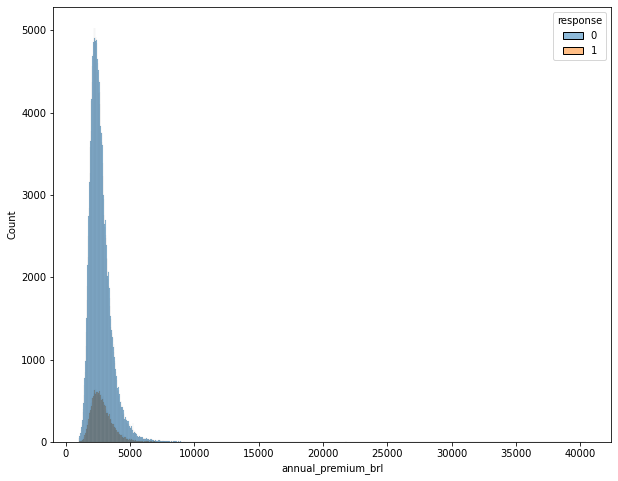

In [43]:
# annual_premium_brl
data_temp = data.loc[data['annual_premium_brl']>1000,['annual_premium_brl','response']]

plt.figure(figsize=(10, 8))
sns.histplot(data = data_temp, x='annual_premium_brl', hue='response')
plt.show()

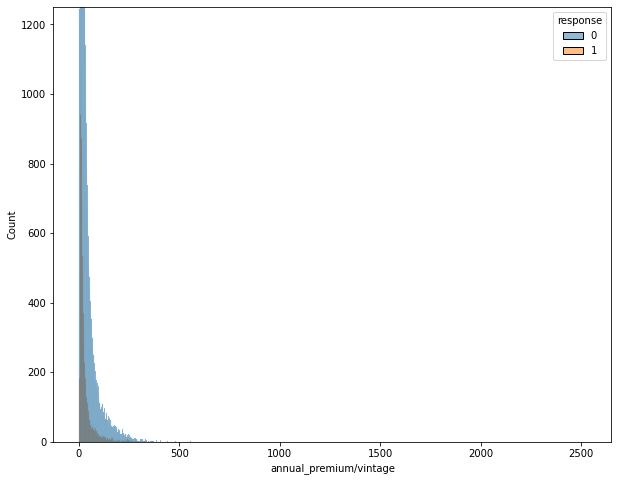

In [44]:
# annual_premium/vintage
data_temp = data.loc[:,['annual_premium/vintage','response']]

plt.figure(figsize=(10, 8))
sns.histplot(data = data_temp, x='annual_premium/vintage', hue='response')
plt.ylim(0,1250)
plt.show()

## Multivariate Analysis

CPU times: user 29min 8s, sys: 1min 50s, total: 30min 58s
Wall time: 28min 55s


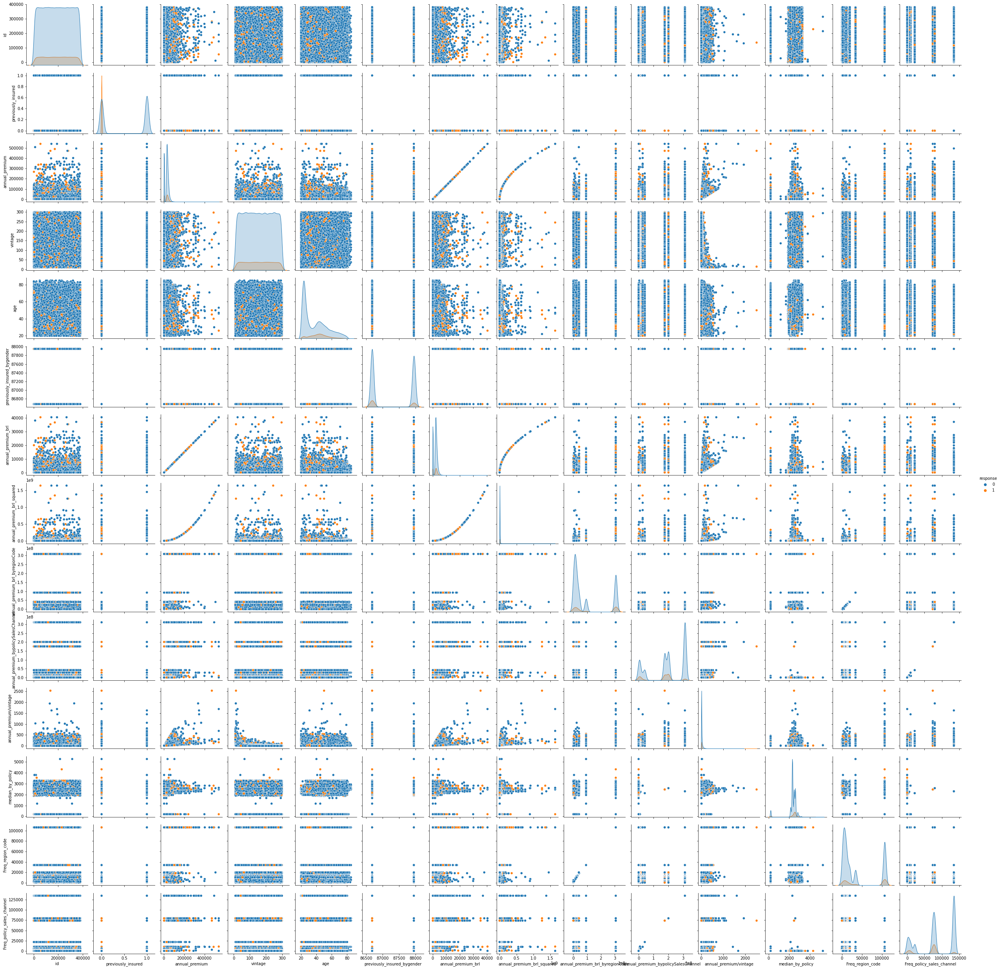

In [46]:
%%time
# Variáveis
variables = data.select_dtypes(['int64','float64']).columns.to_list()
variables.append('response')

sns.pairplot(data[variables], hue='response')

## Correlations

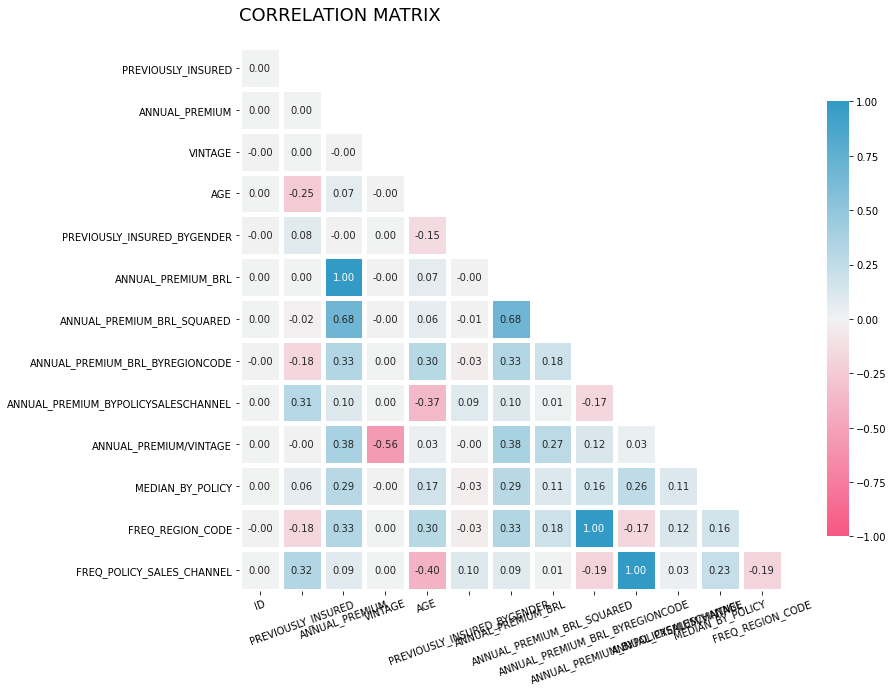

In [45]:
Myheat_map(dataset=data, variaveis=variables)

- As expected annual_premium_brl_squared is well related with annual_premium_brl but its not over 0.70 so we will let to Boruta decide with we keep this variable

- We will drop annual_premium, ID, Freq_policy_sales_channel and Freq_region_code variables due to the correlation between them.

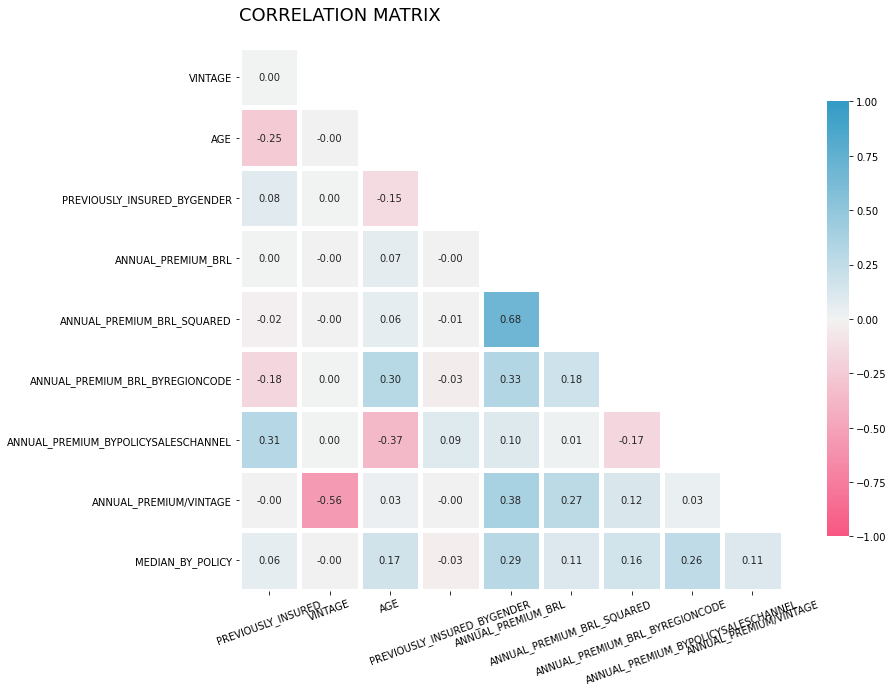

In [46]:
# Removendo variáveis com grande correlação
new_variables = variables.copy()
var_list = ['annual_premium', 'id','Freq_region_code','Freq_policy_sales_channel']

for var in var_list:
    new_variables.remove(var)
Myheat_map(dataset=data, variaveis=new_variables)

Text(0.5, 1.0, 'Pointbiserialr')

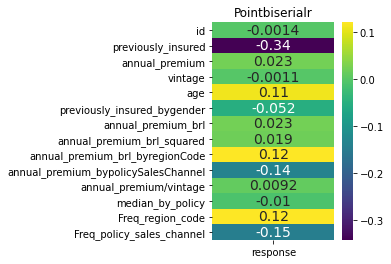

In [47]:
# Numericas com relação a target
variables = data.select_dtypes(['int64','float64']).columns.to_list()

# Correlações
corrs = [pointbiserialr(data['response'], data[var])[0] for var in variables]
df_corr = pd.DataFrame({'response': corrs}, index=variables)

# Plot Matrix
fig, ax = plt.subplots()
plt.subplot(1, 2, 1)
sns.heatmap(df_corr, annot=True, annot_kws={"fontsize":14}, cmap='viridis')
plt.title("Pointbiserialr")

 - We dont have any variable with a high correlation with our Target variable.

## Categorical Variables - cramers v

Text(0.5, 1.0, 'Cramér V')

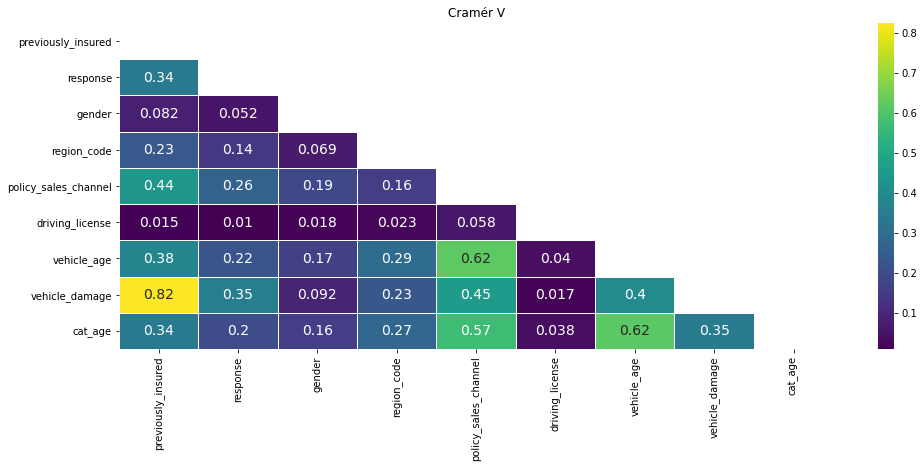

In [48]:
# colunas
data['previously_insured'] = data['previously_insured'].astype('category') 
cols = data.select_dtypes(['category', 'object']).columns.to_list()

# Dicionário para registro das correlações
dictt = {
        'previously_insured': [],
        'response': [],
        'gender': [],
        'region_code': [],
        'policy_sales_channel' : [],
        'driving_license': [],
        'vehicle_age': [],
        'vehicle_damage': [],
        'cat_age': [] 
        }

for col in cols:
    for col1 in cols:
        corr = cramer_v(data[col], data[col1])
        dictt[col].append(corr)
        
# Matriz de Correlação
df_cramer1 = pd.DataFrame(dictt)
df_cramer1 = df_cramer1.set_index(df_cramer1.columns)

# HeatMap
fig, ax = plt.subplots()
ax.figure.set_size_inches(16, 6)

mask = np.triu(np.ones_like(df_cramer1, dtype=np.bool))
sns.heatmap(df_cramer1, mask=mask, linewidths=.5, annot=True, annot_kws={"fontsize":14}, cmap='viridis')
plt.title("Cramér V")

- We can see a strong correlation between vehicle_damage and previously_insured.
- We will see if Boruta algorithm keeps them and experiment dropping one of them as well.

# Insights Report

In [ ]:
# Is the interest diferent by gender?
# Is the annual_premium value diferent by gender?
# Is the annual_premium value diferente by age and the interest?
# Vehicle being damage before changes the annual_premium and the interest? 
# Is the annual_premium value diferente by vehicle_age and the interest?

## Is the interest diferent by gender?

In [49]:
# Percentual of the interest customers by gender
data['response'] = data['response'].astype('int64')
gender_temp = data.groupby('gender')['response'].sum()/data.loc[data['response']==1,:].shape[0]
gender_temp

gender
Female    0.389317
Male      0.610683
Name: response, dtype: float64

In [50]:
data['response'] = data['response'].astype('category')

- Looks like there is more interest by Male Customers

## Is the annual_premium value diferent by gender?

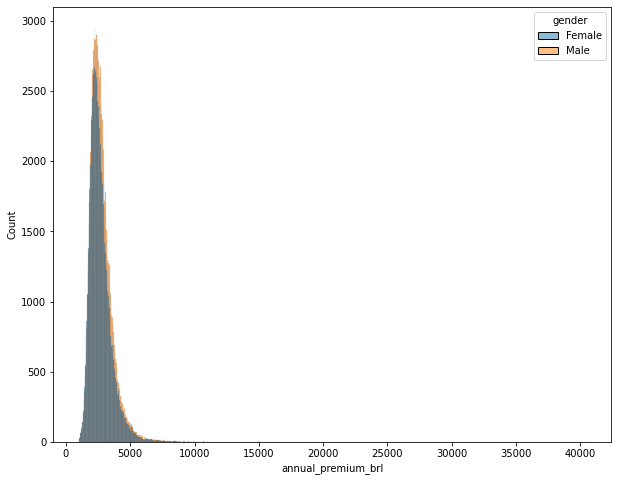

In [51]:
# annual_premium_brl
data_temp = data.loc[data['annual_premium_brl']>1000,['annual_premium_brl','gender']]

plt.figure(figsize=(10, 8))
sns.histplot(data = data_temp, x='annual_premium_brl', hue='gender')
plt.show()

- looks like there is no diference or its to small, lets test this hyphotesis

  H0 - There is no diference.
  
  H1 - THere  a diference. 
  
Oww the null hyphotesis was rejected.

In [52]:
sample_class0 = data.loc[data['gender']=='Male','annual_premium_brl']
sample_class1 = data.loc[data['gender']=='Female','annual_premium_brl']

print(f'The Mean to class Male: {np.mean(sample_class0)}')
print(f'The Mean to class Female: {np.mean(sample_class1)}')
print('\n')

# Testing the Hypothesis
hipo_test(sample_class0, sample_class1)

The Mean to class Male: 2293.636419272741
The Mean to class Female: 2284.134520446806


O valor de p é: 0.023369875916196322
Provável haver diferença


(2.2673423807232473, 0.023369875916196322)

## Is the annual_premium value diferent by age and the what about the interest?

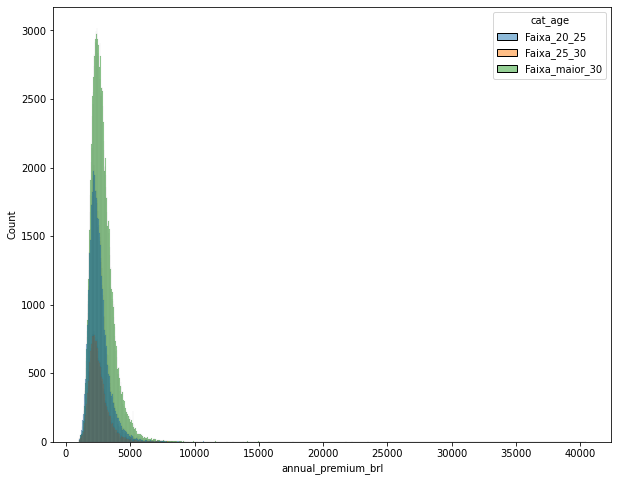

In [53]:
# annual_premium_brl
data_temp = data.loc[data['annual_premium_brl']>1000,['annual_premium_brl','cat_age']]

plt.figure(figsize=(10, 8))
sns.histplot(data = data_temp, x='annual_premium_brl', hue='cat_age')
plt.show()

- Lets test this hyphotesis

  H0 - There is no diference.
  
  H1 - There is  a diference. 

In [54]:
sample_class0 = data.loc[data['cat_age']=='Faixa_20_25','annual_premium_brl']
sample_class1 = data.loc[data['cat_age']=='Faixa_25_30','annual_premium_brl']
sample_class2 = data.loc[data['cat_age']=='Faixa_maior_30','annual_premium_brl']

print(f'The Mean to class Faixa_20_25: {np.mean(sample_class0)}')
print(f'The Mean to class Faixa_25_30: {np.mean(sample_class1)}')
print(f'The Mean to class Faixa_maior_30: {np.mean(sample_class2)}')
print('\n')

# Testing the Hypothesis
hipo_test(sample_class0, sample_class1, sample_class2)

The Mean to class Faixa_20_25: 2309.308415749079
The Mean to class Faixa_25_30: 2155.774125670841
The Mean to class Faixa_maior_30: 2307.420665117319


O valor de p é: 1.5356609965083935e-125
Provável haver diferença


(287.61101027885337, 1.5356609965083935e-125)

- Probably there is a diference between the samples(very low p-value) the insurances to customers between 20 ans 25 are more expensive.

## Vehicle being damaged changes the annual_premium and the interest? 

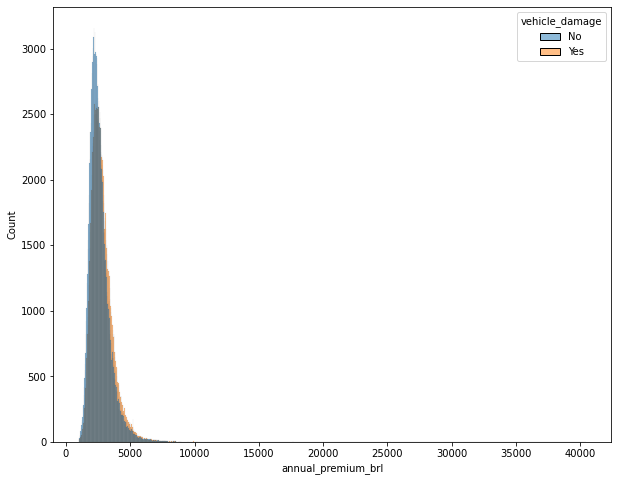

In [55]:
# annual_premium_brl
data_temp = data.loc[data['annual_premium_brl']>1000,['annual_premium_brl','vehicle_damage']]

plt.figure(figsize=(10, 8))
sns.histplot(data = data_temp, x='annual_premium_brl', hue='vehicle_damage')
plt.show()

- Lets test this hyphotesis

  H0 - There is no diference.
  
  H1 - There is  a diference. 

In [56]:
sample_class0 = data.loc[data['vehicle_damage']=='Yes','annual_premium_brl']
sample_class1 = data.loc[data['vehicle_damage']=='No','annual_premium_brl']

print(f'The Mean to class Yes: {np.mean(sample_class0)}')
print(f'The Mean to class No: {np.mean(sample_class1)}')
print('\n')

# Testing the Hypothesis
hipo_test(sample_class0, sample_class1)

The Mean to class Yes: 2301.209487024785
The Mean to class No: 2277.100938828592


O valor de p é: 7.842872862189699e-09
Provável haver diferença


(5.771930875281356, 7.842872862189699e-09)

- Seems that if you have damaged your car you will pay more for your insurance.

## Is the annual_premium value diferente by vehicle_age and the interest?

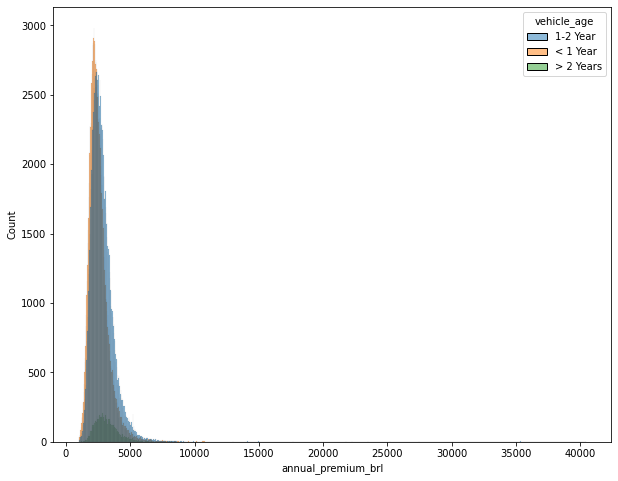

In [57]:
# annual_premium_brl
data_temp = data.loc[data['annual_premium_brl']>1000,['annual_premium_brl','vehicle_age']]

plt.figure(figsize=(10, 8))
sns.histplot(data = data_temp, x='annual_premium_brl', hue='vehicle_age')
plt.show()

- Lets test this hyphotesis

  H0 - There is no diference.
  
  H1 - There is  a diference. 

In [58]:
sample_class0 = data.loc[data['vehicle_age']=='< 1 Year','annual_premium_brl']
sample_class1 = data.loc[data['vehicle_age']=='1-2 Year','annual_premium_brl']
sample_class2 = data.loc[data['vehicle_age']=='> 2 Years','annual_premium_brl']

print(f'The Mean to class < 1 Year: {np.mean(sample_class0)}')
print(f'The Mean to class 1-2 Year: {np.mean(sample_class1)}')
print(f'The Mean to class > 2 Year: {np.mean(sample_class2)}')
print('\n')

# Testing the Hypothesis
hipo_test(sample_class0, sample_class1, sample_class2)

The Mean to class < 1 Year: 2255.954446676295
The Mean to class 1-2 Year: 2286.216300806725
The Mean to class > 2 Year: 2670.522010226776


O valor de p é: 0.0
Provável haver diferença


(758.4558361107574, 0.0)

- Seems that iif your car is new '< 1 Year' the insurance is cheaper.

# Data Preparation

## Spliting Data in training and validation

In [24]:
data_prep = data.copy()

Separanting randomly 76221 observation as test data in order to evaluate the generalization power of the models.

The Xvalid and yvalid dataframes will bne used for tunning the model.

In [25]:
# Splitting X and y 
X= data_prep.drop('response',axis=1)
y= data_prep.response

# Training and Valid data
Xtrain, Xvalid, ytrain, yvalid = train_test_split(X, y, test_size=0.20, shuffle=True, random_state=0)

# Shapes
print(f"Shape of trainning data: {Xtrain.shape}")
print(f"Shape of validation data: {Xvalid.shape}")

Shape of trainning data: (304887, 21)
Shape of validation data: (76222, 21)


## Preparation

 - Drop id, annual_premium, Freq_region_code, Freq_policy_sales_channel
 - Encoding categoricals
 - Standart scaler na var numericas
 - Robust scaler no annual_premium_brl

In [26]:
# Dropping id, annual_premium
Xtrain.drop(['id','annual_premium','Freq_region_code','Freq_policy_sales_channel'], axis=1, inplace=True)
Xvalid.drop(['id','annual_premium','Freq_region_code','Freq_policy_sales_channel'], axis=1, inplace=True)

In [27]:
# Encoding categoricals
categoricals = Xtrain.select_dtypes(include = ['object', 'category']).columns.to_list()
print(categoricals)

# Encoder
enc = OrdinalEncoder()

for cat in categoricals:
    Xtrain[cat] = enc.fit_transform(np.array(Xtrain[cat]).reshape(-1,1))
    Xvalid[cat] = enc.fit_transform(np.array(Xvalid[cat]).reshape(-1,1))

['gender', 'vehicle_age', 'vehicle_damage', 'cat_age']


In [28]:
# Standart Scaler variaveis numericas
numericals = Xtrain.select_dtypes(include = ['int64', 'float64']).columns.to_list()
numericals.remove('annual_premium_brl')
print(numericals)
# Scaler
scaler = StandardScaler()
#power_scaler = PowerTransformer(method='yeo-johnson')

# Encoding
for num in numericals:
    Xtrain[num] = scaler.fit_transform(np.array(Xtrain[num]).reshape(-1,1))
    Xvalid[num] = scaler.transform(np.array(Xvalid[num]).reshape(-1,1))
    
# RobusScaler
var = 'annual_premium_brl'
rscaler = RobustScaler()

# Encoding
Xtrain[var] = rscaler.fit_transform(np.array(Xtrain[var]).reshape(-1,1))
Xvalid[var] = rscaler.transform(np.array(Xvalid[var]).reshape(-1,1))

['previously_insured', 'vintage', 'gender', 'age', 'region_code', 'policy_sales_channel', 'driving_license', 'vehicle_age', 'vehicle_damage', 'previously_insured_bygender', 'annual_premium_brl_squared', 'annual_premium_brl_byregionCode', 'annual_premium_bypolicySalesChannel', 'annual_premium/vintage', 'cat_age', 'median_by_policy']


## SMOTETomek

In [31]:
%%time
# Balancing the data
smt = SMOTETomek(sampling_strategy='minority' ,random_state=42)

Xtrain_smt, ytrain_smt = smt.fit_resample(Xtrain, ytrain)
Xvalid_smt, yvalid_smt = smt.fit_resample(Xvalid, yvalid)

CPU times: user 10min 27s, sys: 697 ms, total: 10min 28s
Wall time: 10min 27s


In [32]:
# All Preparation Done
print(Xtrain_smt.shape)
Xtrain_smt.head()

(522714, 19)


,previously_insured,vintage,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode,annual_premium_bypolicySalesChannel,annual_premium/vintage,cat_age,median_by_policy,Freq_region_code,Freq_policy_sales_channel
0,-0.919399,0.628261,0.921667,-0.891472,-1.844075,0.737858,0.045865,0.839855,-1.010382,-0.921667,-0.165310,-0.168643,-0.759854,1.077905,-0.406959,-1.481154,-0.011918,-0.788564,1.121641
1,-0.919399,-1.667594,0.921667,1.106878,0.121942,-1.586496,0.045865,2.572419,0.989724,-0.921667,1.433089,0.711861,1.578995,0.093389,5.825385,0.781549,0.530858,1.575261,-0.023596
2,1.087667,0.436940,-1.084991,-0.311305,0.273175,0.737858,0.045865,-0.892709,-1.010382,1.084991,-0.379987,-0.247874,-0.642026,1.077905,-0.416176,0.781549,-0.011918,-0.600316,1.121641
3,-0.919399,-1.225164,0.921667,0.268861,0.273175,0.221335,0.045865,-0.892709,0.989724,-0.921667,-0.300934,-0.219773,-0.642026,-0.129852,0.291482,0.781549,0.302884,-0.600316,-0.142208
4,1.087667,1.214183,0.921667,-0.955934,-1.163530,0.737858,0.045865,0.839855,-1.010382,-0.921667,-0.378986,-0.247527,-0.674601,1.077905,-0.479322,-1.481154,-0.011918,-0.668637,1.121641


In [33]:
print(Xvalid_smt.shape)
Xvalid_smt.head()

(131108, 19)


,previously_insured,vintage,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode,annual_premium_bypolicySalesChannel,annual_premium/vintage,cat_age,median_by_policy,Freq_region_code,Freq_policy_sales_channel
0,1.087667,-1.607806,-1.084991,0.462249,1.634263,0.221335,0.045865,-0.892709,-1.010382,1.084991,-1.937625,-0.545953,-0.816030,-0.129852,-0.424447,0.781549,0.302884,-0.773717,-0.142208
1,1.087667,-0.950139,0.921667,0.720101,-1.844075,0.221335,0.045865,-0.892709,-1.010382,-0.921667,0.133489,-0.042981,-0.759854,-0.129852,0.157098,0.781549,0.302884,-0.788564,-0.142208
2,1.087667,0.365195,-1.084991,0.204398,0.197559,0.221335,0.045865,-0.892709,-1.010382,1.084991,1.569313,0.810595,-0.633383,-0.129852,-0.118809,0.781549,0.302884,-0.626315,-0.142208
3,-0.919399,-0.854479,0.921667,0.139935,1.407415,0.221335,0.045865,-0.892709,0.989724,-0.921667,-0.207738,-0.185035,-0.740721,-0.129852,-0.035042,0.781549,0.302884,-0.752383,-0.142208
4,-0.919399,-0.137024,0.921667,0.397786,-1.465994,0.221335,0.045865,-0.892709,0.989724,-0.921667,0.295530,0.032654,-0.774649,-0.129852,-0.202860,0.781549,0.302884,-0.806089,-0.142208


## SMOTEENN

In [32]:
%%time
# Balancing the data
enn = SMOTEENN(random_state=42)

Xtrain_enn, ytrain_enn = enn.fit_resample(Xtrain, ytrain)
Xvalid_enn, yvalid_enn = enn.fit_resample(Xvalid, yvalid)

CPU times: user 10min 26s, sys: 536 ms, total: 10min 26s
Wall time: 10min 26s


In [33]:
# All Preparation Done
print(Xtrain_enn.shape)
Xtrain_enn.head()

(522714, 19)


,previously_insured,vintage,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode,annual_premium_bypolicySalesChannel,annual_premium/vintage,cat_age,median_by_policy,Freq_region_code,Freq_policy_sales_channel
0,-0.919399,0.628261,0.921667,-0.891472,-1.844075,0.737858,0.045865,0.839855,-1.010382,-0.921667,-0.165310,-0.168643,-0.759854,1.077905,-0.406959,-1.481154,-0.011918,-0.788564,1.121641
1,-0.919399,-1.667594,0.921667,1.106878,0.121942,-1.586496,0.045865,2.572419,0.989724,-0.921667,1.433089,0.711861,1.578995,0.093389,5.825385,0.781549,0.530858,1.575261,-0.023596
2,1.087667,0.436940,-1.084991,-0.311305,0.273175,0.737858,0.045865,-0.892709,-1.010382,1.084991,-0.379987,-0.247874,-0.642026,1.077905,-0.416176,0.781549,-0.011918,-0.600316,1.121641
3,-0.919399,-1.225164,0.921667,0.268861,0.273175,0.221335,0.045865,-0.892709,0.989724,-0.921667,-0.300934,-0.219773,-0.642026,-0.129852,0.291482,0.781549,0.302884,-0.600316,-0.142208
4,1.087667,1.214183,0.921667,-0.955934,-1.163530,0.737858,0.045865,0.839855,-1.010382,-0.921667,-0.378986,-0.247527,-0.674601,1.077905,-0.479322,-1.481154,-0.011918,-0.668637,1.121641


In [34]:
print(Xvalid_enn.shape)
Xvalid_enn.head()

(131108, 19)


,previously_insured,vintage,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,previously_insured_bygender,annual_premium_brl,annual_premium_brl_squared,annual_premium_brl_byregionCode,annual_premium_bypolicySalesChannel,annual_premium/vintage,cat_age,median_by_policy,Freq_region_code,Freq_policy_sales_channel
0,1.087667,-1.607806,-1.084991,0.462249,1.634263,0.221335,0.045865,-0.892709,-1.010382,1.084991,-1.937625,-0.545953,-0.816030,-0.129852,-0.424447,0.781549,0.302884,-0.773717,-0.142208
1,1.087667,-0.950139,0.921667,0.720101,-1.844075,0.221335,0.045865,-0.892709,-1.010382,-0.921667,0.133489,-0.042981,-0.759854,-0.129852,0.157098,0.781549,0.302884,-0.788564,-0.142208
2,1.087667,0.365195,-1.084991,0.204398,0.197559,0.221335,0.045865,-0.892709,-1.010382,1.084991,1.569313,0.810595,-0.633383,-0.129852,-0.118809,0.781549,0.302884,-0.626315,-0.142208
3,-0.919399,-0.854479,0.921667,0.139935,1.407415,0.221335,0.045865,-0.892709,0.989724,-0.921667,-0.207738,-0.185035,-0.740721,-0.129852,-0.035042,0.781549,0.302884,-0.752383,-0.142208
4,-0.919399,-0.137024,0.921667,0.397786,-1.465994,0.221335,0.045865,-0.892709,0.989724,-0.921667,0.295530,0.032654,-0.774649,-0.129852,-0.202860,0.781549,0.302884,-0.806089,-0.142208


# Feature Selection

## With SMOTETomek

In [34]:
%%time
# Modelo
model = lgb.LGBMClassifier()

#Selecionador de Features
Feature_Selector = BorutaShap(model=model,
                              importance_measure='shap',
                              classification=True, )

Feature_Selector.fit(X=Xtrain_smt,y=ytrain_smt, n_trials=10, random_state=1)

100%|██████████| 10/10 [05:14<00:00, 31.47s/it]

10 attributes confirmed important: ['previously_insured', 'median_by_policy', 'age', 'vehicle_damage', 'policy_sales_channel', 'Freq_region_code', 'annual_premium_bypolicySalesChannel', 'region_code', 'annual_premium_brl', 'annual_premium_brl_byregionCode']
2 attributes confirmed unimportant: ['driving_license', 'vehicle_age']
7 tentative attributes remains: ['annual_premium/vintage', 'annual_premium_brl_squared', 'cat_age', 'previously_insured_bygender', 'Freq_policy_sales_channel', 'vintage', 'gender']
CPU times: user 1h 16min 16s, sys: 7.12 s, total: 1h 16min 23s
Wall time: 5min 14s


In [35]:
# Visualizando as variáveis selecioandas
X_subset = Feature_Selector.Subset()
X_subset.head()

,previously_insured,median_by_policy,age,vehicle_damage,policy_sales_channel,Freq_region_code,annual_premium_bypolicySalesChannel,region_code,annual_premium_brl,annual_premium_brl_byregionCode
0,-0.919399,-0.011918,-0.891472,-1.010382,0.737858,-0.788564,1.077905,-1.844075,-0.165310,-0.759854
1,-0.919399,0.530858,1.106878,0.989724,-1.586496,1.575261,0.093389,0.121942,1.433089,1.578995
2,1.087667,-0.011918,-0.311305,-1.010382,0.737858,-0.600316,1.077905,0.273175,-0.379987,-0.642026
3,-0.919399,0.302884,0.268861,0.989724,0.221335,-0.600316,-0.129852,0.273175,-0.300934,-0.642026
4,1.087667,-0.011918,-0.955934,-1.010382,0.737858,-0.668637,1.077905,-1.163530,-0.378986,-0.674601


## With SMOTEENN

In [37]:
%%time
# Modelo
model = lgb.LGBMClassifier()

#Selecionador de Features
Feature_Selector = BorutaShap(model=model,
                              importance_measure='shap',
                              classification=True, )

Feature_Selector.fit(X=Xtrain_enn,y=ytrain_enn, n_trials=10, random_state=1)

100%|██████████| 10/10 [05:31<00:00, 33.11s/it]

10 attributes confirmed important: ['annual_premium_bypolicySalesChannel', 'vehicle_damage', 'median_by_policy', 'previously_insured', 'annual_premium_brl_byregionCode', 'annual_premium_brl', 'policy_sales_channel', 'Freq_region_code', 'region_code', 'age']
2 attributes confirmed unimportant: ['driving_license', 'vehicle_age']
7 tentative attributes remains: ['annual_premium/vintage', 'gender', 'vintage', 'previously_insured_bygender', 'cat_age', 'Freq_policy_sales_channel', 'annual_premium_brl_squared']
CPU times: user 1h 17min 8s, sys: 9.99 s, total: 1h 17min 18s
Wall time: 5min 31s


In [39]:
# Visualizando as variáveis selecioandas
X_subset_enn = Feature_Selector.Subset()
X_subset_enn.head()

,annual_premium_bypolicySalesChannel,vehicle_damage,median_by_policy,previously_insured,annual_premium_brl_byregionCode,annual_premium_brl,policy_sales_channel,Freq_region_code,region_code,age
0,1.077905,-1.010382,-0.011918,-0.919399,-0.759854,-0.165310,0.737858,-0.788564,-1.844075,-0.891472
1,0.093389,0.989724,0.530858,-0.919399,1.578995,1.433089,-1.586496,1.575261,0.121942,1.106878
2,1.077905,-1.010382,-0.011918,1.087667,-0.642026,-0.379987,0.737858,-0.600316,0.273175,-0.311305
3,-0.129852,0.989724,0.302884,-0.919399,-0.642026,-0.300934,0.221335,-0.600316,0.273175,0.268861
4,1.077905,-1.010382,-0.011918,1.087667,-0.674601,-0.378986,0.737858,-0.668637,-1.163530,-0.955934


# Machine Learning Models

In this section we are going to test several ML models and see what peforms best.

    - Logistic Regression
    - Decision Tree
    - ExtraTrees
    - LGBM
    - BalancedRandomForest 

In [ ]:
# Logistic Regression Model

In [ ]:
# Decision Tree Model

## Extra Trees Model

In [43]:
%%time

# params
max_depth = [1, 3, 5, 8, 12, 15]
min_sample_leaf = [1, 3, 5, 8, 12, 15]

# Data
data_train = pd.concat([Xtrain, ytrain], axis=1) 
data_test = pd.concat([Xvalid, yvalid], axis=1) 

# cache metrics
metrics_min_sample_leaf = []
metrics_max_depth = []


# Iterating over min_sample_leaf
for param in min_sample_leaf:
    # Model
    model = ExtraTreesClassifier(max_depth=None , min_samples_leaf=param)

    # Evaluation
    _, recall_k = model_selection(data_train=data_train,
                                     data_test=data_test,
                                     model=model,
                                     model_name="ExtraTreeModel",
                                     k=20000)
    metrics_min_sample_leaf.append(recall_k)

df_plot = pd.DataFrame({'recall_at_k':metrics,
                        'min_sample_leaf':min_sample_leaf})

#----------------------------------------------------------------------------------------------------------------------------------

# Iterating over max_depth
for param in max_depth:
    # Model
    model = ExtraTreesClassifier(max_depth=param , min_samples_leaf=1)

    # Evaluation
    _, recall_k = model_selection(data_train=data_train,
                                     data_test=data_test,
                                     model=model,
                                     model_name="ExtraTreeModel",
                                     k=20000)
    metrics_max_depth.append(recall_k)

df_plot2 = pd.DataFrame({'recall_at_k':metrics_max_depth,
                        'max_depth':max_depth})

CPU times: user 3min 56s, sys: 444 ms, total: 3min 56s
Wall time: 3min 57s


<AxesSubplot:xlabel='min_sample_leaf', ylabel='recall_at_k'>

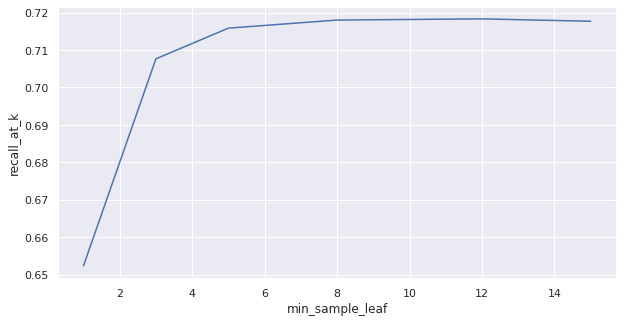

In [44]:
# Performance tunning min_sample_leaf
plt.figure(figsize=(10,5))
sns.set_theme(style="darkgrid")
sns.lineplot(x='min_sample_leaf', y='recall_at_k', data=df_plot)

<AxesSubplot:xlabel='max_depth', ylabel='recall_at_k'>

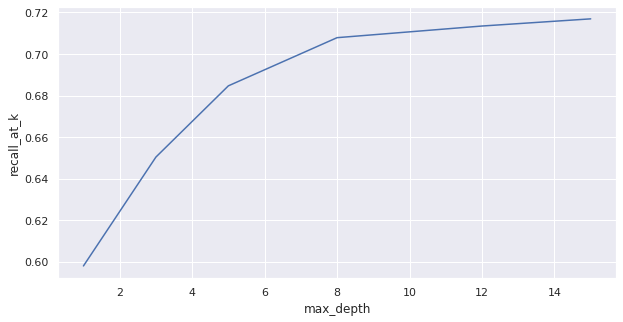

In [45]:
# Performance tunning max_depth
plt.figure(figsize=(10,5))
sns.set_theme(style="darkgrid")
sns.lineplot(x='max_depth', y='recall_at_k', data=df_plot2)

We can see that there is almost no diference beteween tunning max_depth and min_samples_leaf then we will keep max_depth with its default value "None" and min_sample_leaf of 10 were we achieved a plateau.

### Evaluate the ExtraTrees at 20000 calls

,Model name,precision_at_k,recall_at_k
0,extra_tree_model.sav,0.333933,0.72003


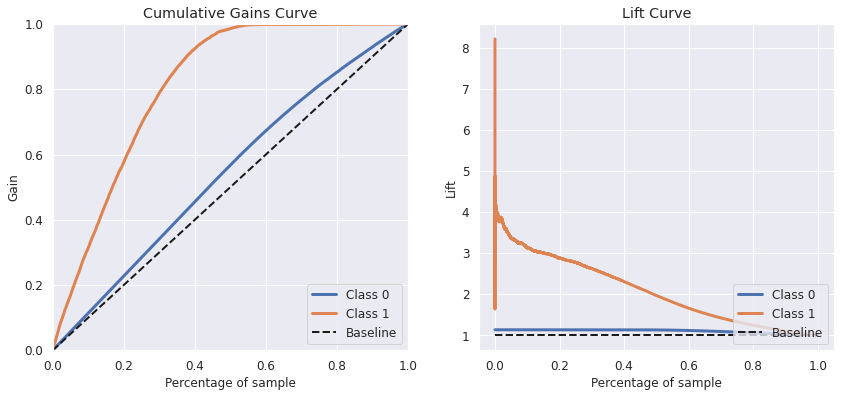

In [76]:
# ExtraTree Model
model_Extra = ExtraTreesClassifier(n_estimators=500,
                                   min_samples_leaf=10,
                                   max_depth=None)

# Evaluation
painel, extratree_model_20000 = train_evaluate_model( data_train=data_train,
                                                            data_test=data_test,
                                                            model=model_Extra,
                                                            model_name='extra_tree_model.sav')

# Metrics Painel
painel

### Evaluate the ExtraTrees at 40000 calls

,Model name,precision_at_k,recall_at_k
0,extra_tree_model.sav,0.230294,0.9931


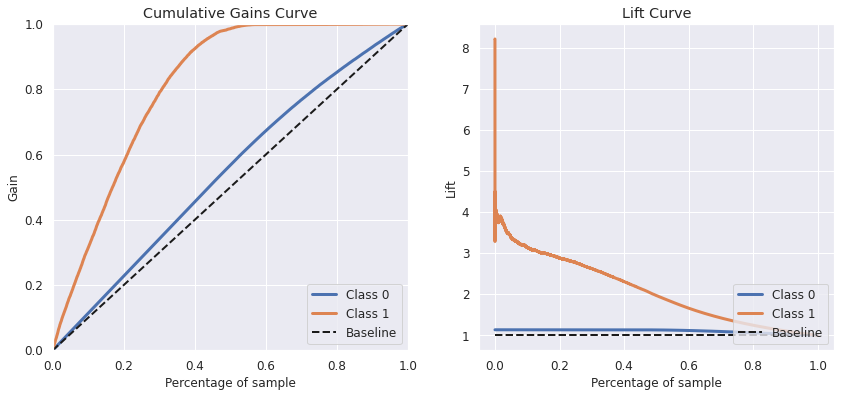

In [77]:
# Evaluation
painel, extratree_model_smt_40000 = train_evaluate_model( data_train=data_train,
                                                            data_test=data_test,
                                                            model=model_Extra,
                                                            model_name='extra_tree_model.sav',
                                                            k=40000)

# Metrics Painel
painel

### Testing Guassian optimization ExtraTrees

In [57]:
#Tunning Parameters Xtrain ytrain Xvalid yvalid

param = [(100, 250, 500),
         (10, 20, 50),
         (31, 70, 100)]

def extraTree_tune(params):
    print(params)
    
    n_estimators = params[0]
    max_depth = params[1]
    min_samples_leaf = params[2]
    
    #Model
    model = ExtraTreesClassifier(n_estimators=n_estimators,
                                 min_samples_leaf=min_samples_leaf,
                                 max_depth=max_depth)
    
    model.fit(Xtrain, ytrain)
    
    #Model Name
    model_name = type(model).__name__
    
    #Prediction
    yhat_proba = model.predict_proba(Xvalid)[:,1]
    
    #Reconstruct dataframe
    full_val = pd.concat([Xvalid, yvalid], axis=1)
    full_val['score'] = yhat_proba
    full_val = full_val.sort_values('score', ascending=False)
    
    # Metrics
    recall_at = recall_at_k(full_val, 20000)
    
    return -recall_at

In [60]:
%%time
result = forest_minimize(extraTree_tune, param, random_state=42, n_random_starts=15, n_calls=15, verbose=1 )

Iteration No: 1 started. Evaluating function at random point.
[500, 10, 100]
Iteration No: 1 ended. Evaluation done at random point.
Time taken: 79.5016
Function value obtained: -0.7095
Current minimum: -0.7095
Iteration No: 2 started. Evaluating function at random point.
[250, 20, 31]
Iteration No: 2 ended. Evaluation done at random point.
Time taken: 49.7379
Function value obtained: -0.7178
Current minimum: -0.7178
Iteration No: 3 started. Evaluating function at random point.
[250, 20, 31]
Iteration No: 3 ended. Evaluation done at random point.
Time taken: 47.2036
Function value obtained: -0.7176
Current minimum: -0.7178
Iteration No: 4 started. Evaluating function at random point.
[250, 10, 100]
Iteration No: 4 ended. Evaluation done at random point.
Time taken: 39.3878
Function value obtained: -0.7104
Current minimum: -0.7178
Iteration No: 5 started. Evaluating function at random point.
[500, 10, 100]
Iteration No: 5 ended. Evaluation done at random point.
Time taken: 79.0332
Funct

In [72]:
# Best parameters
result.x

[100, 20, 31]

Any relevant diference!!! 

## LGBMClassifier

Since we already know the parameters for our trees lets test a LGBM model and see the result.

### Evaluate the LGBM Model with 20000 calls.

,Model name,precision_at_k,recall_at_k
0,lgbm_model.sav,0.333683,0.719491


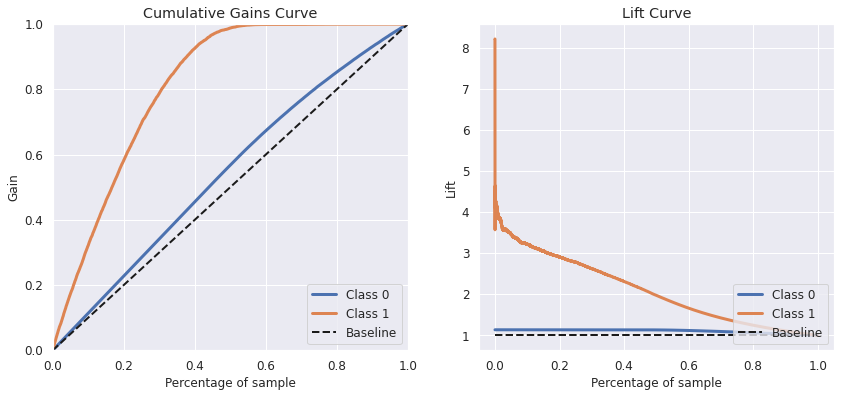

In [78]:
# Model
model_lgb = lgb.LGBMClassifier(n_estimators=500,
                               learning_rate=0.01,
                               min_child_samples=10,
                               max_depth =None,
                               n_jobs=-1)

# Evaluation
painel, lgbm_model_20000 = train_evaluate_model( data_train=data_train,
                                                      data_test=data_test,
                                                      model=model_lgb,
                                                      model_name='lgbm_model.sav')

# Metrics Painel
painel

### Evaluate the LGBM Model with 40000 calls.

,Model name,precision_at_k,recall_at_k
0,LGBM_model.sav,0.230494,0.993963


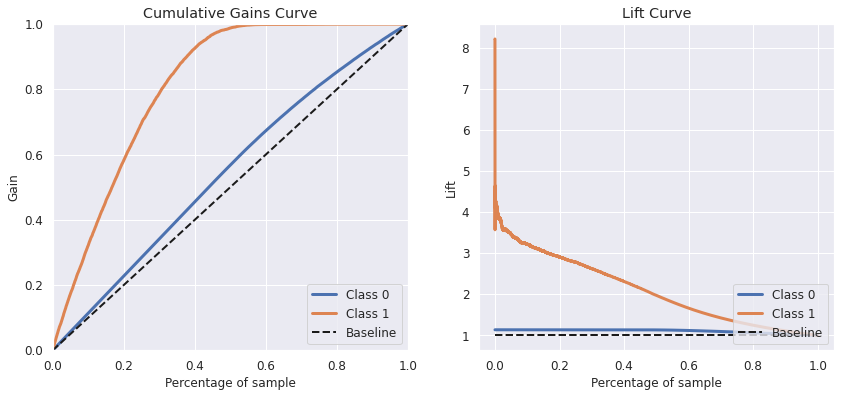

In [82]:
# Evaluation
painel, lgbm_model_40000 = train_evaluate_model( data_train=data_train,
                                                      data_test=data_test,
                                                      model=model_lgb,
                                                      model_name='LGBM_model.sav',
                                                      k=40000)

# Metrics Painel
painel

## Balanced Random Forest 

### Evaluate the Balanced Random Forest Model with 20000 calls.

,Model name,precision_at_k,recall_at_k
0,BalancedRF_model.sav,0.332333,0.71658


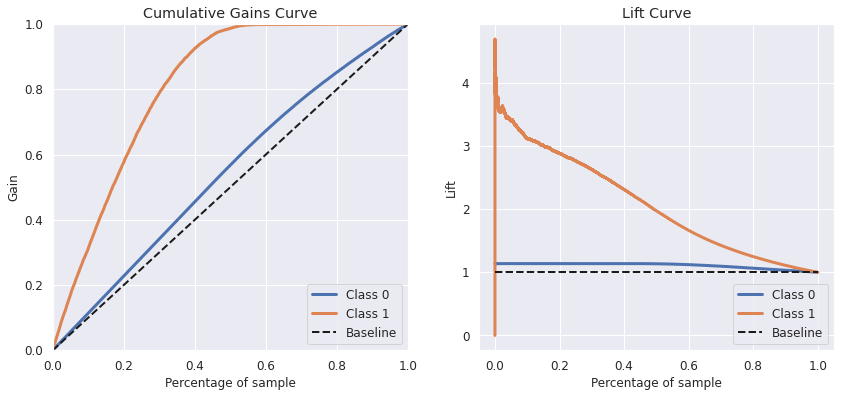

In [83]:
model_brf = BalancedRandomForestClassifier(n_estimators=500, max_depth=None, min_samples_leaf=10, random_state=0)

# Evaluation
painel, brf_model_20000 = train_evaluate_model( data_train=data_train,
                                                      data_test=data_test,
                                                      model=model_brf,
                                                      model_name='BalancedRF_model.sav')

# Metrics Painel
painel

### Evaluate the Balanced Random Forest Model with 40000 calls.

,Model name,precision_at_k,recall_at_k
0,BalancedRF_model.sav,0.230594,0.994394


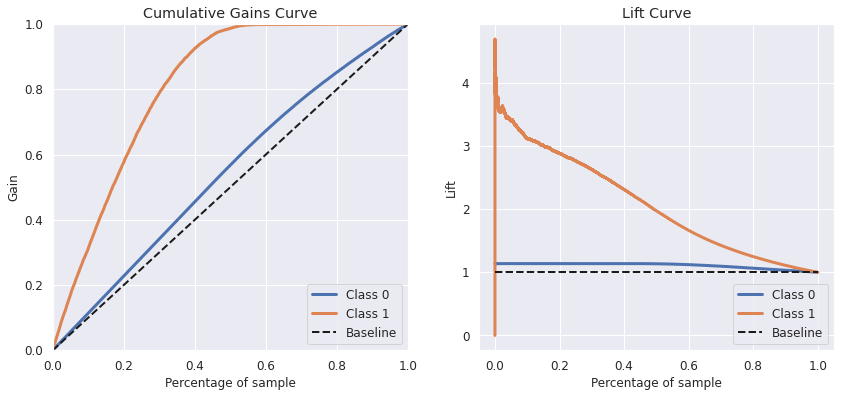

In [84]:
# Evaluation
painel, brf_model_40000 = train_evaluate_model( data_train=data_train,
                                                    data_test=data_test,
                                                    model=model_brf,
                                                    model_name='BalancedRF_model.sav',
                                                    k=40000)

# Metrics Painel
painel

## Bussines Points

What percentange of the interessed customers would be interessed with 20000 calls and 40000.

   - With our ExtraTree Model we achieved a 72% of the interessed customers.
    
   - Wirh 40000 calls we can bump up this percentage to 99%.

Because of that we will take the ExtraTree Model to production.

# Creating the Production Pipeline Pickle

In [5]:
# Splitting X and y 
X= data.drop('response',axis=1)
y= data.response

In [57]:
%%time

pipeline = HealthInsurance()
                           
model =RUSBoostClassifier(n_estimators=200, 
                          algorithm='SAMME.R', 
                          random_state=0)

data_processed = pipeline.fit_transform(X)
modelo = model.fit(data_processed, y)

CPU times: user 27.7 s, sys: 648 ms, total: 28.4 s
Wall time: 28.4 s


In [58]:
# Saving Pipelines Pickle
with open('models/pipeline_production.pkl', 'wb') as Pipeline:
    pickle.dump(pipeline, Pipeline)

In [59]:
# Saving Model Pickle
with open('models/modelo_final.pkl', 'wb') as Modelo:
    pickle.dump(modelo, Modelo)

# API Testing

In [5]:
# Example Data
api_test_data = data.sample(50)

# Tunning into a json
df_json = api_test_data.to_json(orient='records')
df_json

'[{"id":181323,"previously_insured":1,"annual_premium":56077.0,"vintage":69,"response":0,"gender":"Female","age":25,"region_code":41.0,"policy_sales_channel":152.0,"driving_license":1,"vehicle_age":"< 1 Year","vehicle_damage":"No"},{"id":134876,"previously_insured":0,"annual_premium":2630.0,"vintage":56,"response":0,"gender":"Female","age":26,"region_code":32.0,"policy_sales_channel":152.0,"driving_license":1,"vehicle_age":"< 1 Year","vehicle_damage":"Yes"},{"id":6452,"previously_insured":0,"annual_premium":30174.0,"vintage":213,"response":0,"gender":"Male","age":35,"region_code":15.0,"policy_sales_channel":26.0,"driving_license":1,"vehicle_age":"1-2 Year","vehicle_damage":"Yes"},{"id":350657,"previously_insured":0,"annual_premium":31943.0,"vintage":21,"response":0,"gender":"Male","age":25,"region_code":36.0,"policy_sales_channel":152.0,"driving_license":1,"vehicle_age":"< 1 Year","vehicle_damage":"No"},{"id":47110,"previously_insured":0,"annual_premium":44448.0,"vintage":259,"response

In [6]:
## API Prediction
url = 'http://172.17.0.2:5000/predict' # endpoint Docker
#url = 'https://health-insurance-score.herokuapp.com/predict' # endpoint Heroku
data = df_json
header = {'Content-type':'application/json'}

# Request
r = requests.post(url=url, data=data, headers=header)
print(f'Status Score: {r.status_code}')
score = pd.DataFrame(r.json(), columns=r.json()[0].keys())
score.sort_values('score',ascending=False)

Status Score: 200


,id,previously_insured,annual_premium,vintage,response,gender,age,region_code,policy_sales_channel,driving_license,vehicle_age,vehicle_damage,score
29,70177,0,33719.0,139,0,Male,20,39.0,160.0,1,< 1 Year,Yes,0.501078
47,309699,0,45028.0,256,0,Male,24,15.0,152.0,1,< 1 Year,Yes,0.500976
48,62055,1,2630.0,229,0,Female,46,35.0,124.0,1,1-2 Year,No,0.500940
42,250662,0,19549.0,14,0,Female,22,46.0,160.0,1,< 1 Year,No,0.500899
46,327735,0,43373.0,239,0,Male,45,8.0,26.0,1,1-2 Year,Yes,0.500889
38,207486,1,34770.0,213,0,Female,43,14.0,26.0,1,1-2 Year,No,0.500873
39,249696,1,50107.0,141,0,Male,26,28.0,26.0,1,1-2 Year,No,0.500860
20,336470,0,36125.0,106,0,Male,38,47.0,124.0,1,1-2 Year,Yes,0.500860
49,179595,1,30948.0,45,0,Female,24,33.0,152.0,1,< 1 Year,No,0.500838
40,371843,1,37293.0,72,0,Female,26,41.0,152.0,1,< 1 Year,No,0.500295


In [11]:
# Saving .csv to upload it as google sheet
score.to_csv('data/score.csv', index=False, header=True)